In [22]:
# Install dependencies
#! pip install opencv-python
#! pip install ultralytics
#! pip install albumentations
#! pip install torch torchvision torchaudio --upgrade

In [1]:
# Do imports here
#from google.colab import drive
import os
from ultralytics import YOLO # import YOLO 8
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm, trange
import numpy as np
from glob import glob
import torch
import shutil

In [2]:
torch.cuda.is_available()

True

In [3]:
torch.cuda.device_count()

1

In [5]:
#drive.mount('/content/drive')

In [6]:
# define constants

random_seed = 2024


# Project Overview
% This section should contain a brief description of the project and what you are trying to achieve.

The aim of this project is to develop a deep learning model to detect and classify cyclists, pedestrians and vehicles in cities using video. We will prepare an open source dataset and use the open source real-time object detection YOLO (you only look once). As a reference, we will use our untrained model and compare it with the trained model.

# Set up

% This section should contain a brief description of the steps to follow to run the code.

The whole project was implemented in this Google Colab Jupyter notebook. To run the code, just press run all in this environment. For performance reasons it would be better to run it locally, if you do please check all paths.

# Dataset

## General Information on the dataset

Source of the dataset:
https://www.vis.xyz/bdd100k/

We decided on using the BDD100k images datset, these are images which were collected by taking an image from the BDD100k video dataset at every 0.1 seconds. The Data was collected in America (New York, San Francisco, Bay Area and Berkley) and is capturing a wide variety of driving environments, weather conditions, and times of day. It also includes detailed annotations for tasks like object detection, segmentation, and lane detection. #Todo:
The Images are of size xxxx and the entire Dataset has xx Gb.

###Labels

Our specific version of the BDD100k dataset has the following labels for object detection:

0: person<br>
1: rider<br>
2: car<br>
3: bus<br>
4: truck<br>
5: bike<br>
6: motor<br>
7: tl_green<br>
8: tl_red<br>
9: tl_yellow<br>
10: tl_none<br>
11: traffic sign<br>
12: train<br>




### Why BDD100k?

BDD100K was one of the datasets which fulfilled our requirements for a good dataset, which were diversity of scenarios, comprehensive annotations and compatibility with yolo. Its over 100,000 images, were captured across different urban environments, weather conditions, and times of day, which provide the necessary variety to train a robust model and the detailed annotations for bicycle, pedestrian, and vehicle align perfectly with our requirements.


Since there are multiple BDD100k annotation files supporting a wide range of different tasks, the annotation files need to be converted into Yolov9 format. While there are already converted label files available online, we found these to be erroneous and therefore used code from the following source to convert the labels ourselves: https://github.com/williamhyin/yolov5s_bdd100k/blob/master/Bdd_preprocessing.ipynb

Our converted and zipped (original) dataset can be found here: https://drive.google.com/drive/folders/1Y-YbA3y2qKDBhQIfvnAhnCPbTX6-5ik8?usp=sharing

We create the following code to obtain our own BDD10k training and validation splits:

In [11]:
# Extract bdd100k dataset (Only needed when running on Google Colab)
#! unzip "drive/MyDrive/JKU/ItAV/task1/dataset/yolo-bdd100k.zip"

In [12]:
# Extract bdd10k dataset
#! unzip "drive/MyDrive/JKU/ItAV/task1/dataset/yolo-bdd10k.zip"

## Dataset preparation

This section should detail your dataset preparation strategy (pre-processing, data augmentation) and justify your approach.

### Get 10K samples from BDD100K

As the Yolo v8 model is already trained on a relatively huge dataset (COCO128), doing transfer learning on the complete BDD100k dataset is unnecessary and takes too much time and resources.

So we take a portion of this dataset and we call it BDD10k, which is not the same as the BDD10k which is released by BAIR but we only take the first 10K data points from BDD100k train set.


In [16]:
# Code used to get 10k images from the BDD100K dataset
# Not needed when BDD-10K is already downloaded or generated!
"""

k10_train_length = 10_000
k10_val_length = np.ceil((10_000 / 70_000) * 10_000) # Take validation set proportional to train set

# Get bdd100k train and validation sample file paths
k100_train_paths = glob(os.path.join('dataset/yolo-bdd100k', 'images', 'train', '*.jpg' ))
k100_val_paths = glob(os.path.join('dataset/yolo-bdd100k', 'images', 'val', '*.jpg' ))

# Create directories for storing bdd10k dataset
! mkdir dataset/yolo-bdd10k
! mkdir dataset/yolo-bdd10k/images
! mkdir dataset/yolo-bdd10k/images/train
! mkdir dataset/yolo-bdd10k/images/val
! mkdir dataset/yolo-bdd10k/labels
! mkdir dataset/yolo-bdd10k/labels/train
! mkdir dataset/yolo-bdd10k/labels/val

for index in trange(k10_train_length):
  if index < k10_val_length:
    image_path = k100_val_paths[index]
    image_dest = image_path.replace('yolo-bdd100k', 'yolo-bdd10k')
    shutil.copy(image_path, image_dest)
    shutil.copy(
        image_path.replace('images', 'labels').replace('jpg', 'txt'),
        image_dest.replace('images', 'labels').replace('jpg', 'txt')
          )
  image_path = k100_train_paths[index]
  image_dest = image_path.replace('yolo-bdd100k', 'yolo-bdd10k')
  shutil.copy(image_path, image_dest)
  try:
    shutil.copy(
          image_path.replace('images', 'labels').replace('jpg', 'txt'),
          image_dest.replace('images', 'labels').replace('jpg', 'txt')
            )
  except FileNotFoundError:
    print(f"No label for {image_path}")


# Make a copy from bdd100k dataset.yaml file
! cp dataset/yolo-bdd100k/dataset.yaml dataset/yolo-bdd10k/dataset.yaml


# Read in the dataset.yaml file
with open('dataset/yolo-bdd10k/dataset.yaml', 'r') as file:
  filedata = file.read()

# Replace bdd100k with bdd10k in yaml file
filedata = filedata.replace('yolo-bdd100k', 'yolo-bdd10k')

# Write the file out again
with open('dataset/yolo-bdd10k/dataset.yaml', 'w') as file:
  file.write(filedata)

# Create a zip from bdd10k dataset files
! zip -r yolo-bdd10k.zip dataset/yolo-bdd10k/

!cp  "./yolo-bdd10k.zip" "./drive/MyDrive/JKU/ItAV/task1/dataset/yolo-bdd10k.zip"
"""
print()

### Data Augmentation

Since Yolo already has an integrated data augmentation strategy and we want to augment preferably during runtime, we will use and discuss Data Augmentation in the Training section.

# Dataset analysis

## Size of the Dataset and Count of each Label

First we will simply look at our dataset size:

In [17]:
class_names = ["person", "rider", "car", "bus", "truck", "bike", "motor", "tl_green", "tl_red", "tl_yellow", "tl_none", "traffic sign", "train"]
colors = ["red", "green", "blue", "orange", "purple", "brown", "pink", "gray", "olive", "cyan", "magenta", "lime", "navy"]
train_label_dir = "datasets/yolo-bdd10k/labels/train"
val_label_dir = "datasets/yolo-bdd10k/labels/val"
train_image_dir = "datasets/yolo-bdd10k/images/train"
val_image_dir = "datasets/yolo-bdd10k/images/val"

print(f'Number of samples in the training set: {len(os.listdir(train_image_dir))}')
print(f'Number of samples in the validation set: {len(os.listdir(val_image_dir))}')

Number of samples in the training set: 10000
Number of samples in the validation set: 1429


Next we will look at the amount of times each label appears:

C:\Users\tom\AppData\Local\Temp\ipykernel_5388\3720630366.py:40: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


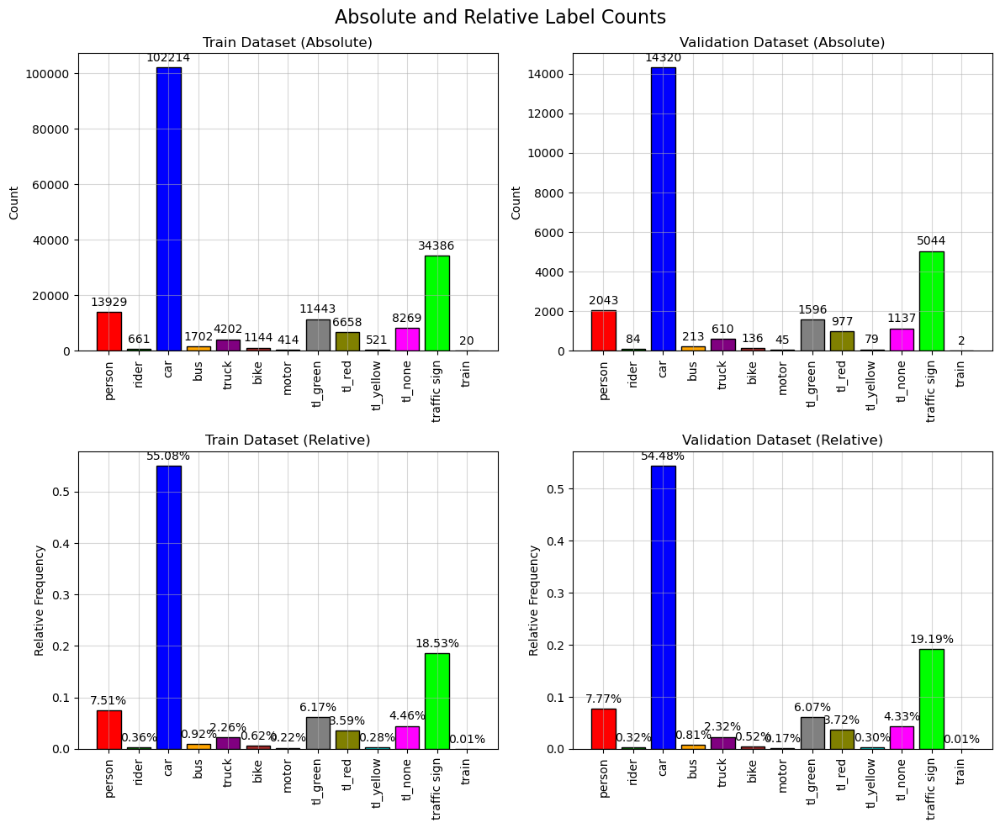

In [18]:
def count_labels(label_dir, class_names):
    counts = np.zeros(len(class_names))

    for label_file in os.listdir(label_dir):
        with open(os.path.join(label_dir, label_file), 'r') as file:
            for line in file:
                class_id = int(float(line.split()[0]))
                counts[class_id] += 1

    return counts

train_counts = count_labels(train_label_dir, class_names)
val_counts = count_labels(val_label_dir, class_names)

relative_train_counts = train_counts / np.sum(train_counts)
relative_val_counts = val_counts / np.sum(val_counts)

# Plotting
fig, axs = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
fig.suptitle('Absolute and Relative Label Counts', fontsize=16)
x = np.arange(len(class_names))  # Class indices for bar positions
def plot_counts(ax, counts, title, is_relative=False):
    bars = ax.bar(x, counts, color=colors, edgecolor='black')
    ax.set_title(title)
    ax.set_xticks(x)
    ax.set_xticklabels(class_names, rotation=90)
    ax.set_ylabel('Count' if not is_relative else 'Relative Frequency')
    ax.grid(True,alpha = 0.5)

    for bar, count in zip(bars, counts):
        label = f'{int(count)}' if not is_relative else f'{count / np.sum(counts):.2%}'
        ax.annotate(label, xy=(bar.get_x() + bar.get_width() / 2, bar.get_height()), xytext=(0, 3),
                    textcoords="offset points", ha='center', va='bottom')

plot_counts(axs[0, 0], train_counts, 'Train Dataset (Absolute)')
plot_counts(axs[0, 1], val_counts, 'Validation Dataset (Absolute)')
plot_counts(axs[1, 0], relative_train_counts, 'Train Dataset (Relative)', is_relative=True)
plot_counts(axs[1, 1], relative_val_counts, 'Validation Dataset (Relative)', is_relative=True)

plt.tight_layout()
plt.show()


From these plots we can see, that the most frequent labels, like car, traffic sign and person make up a huge majority of the labels, while other labels like rider, train or motorcycle barely appear.

## Object Count per Image

In the next plot we will look at the distribution of how may objects each picture has.

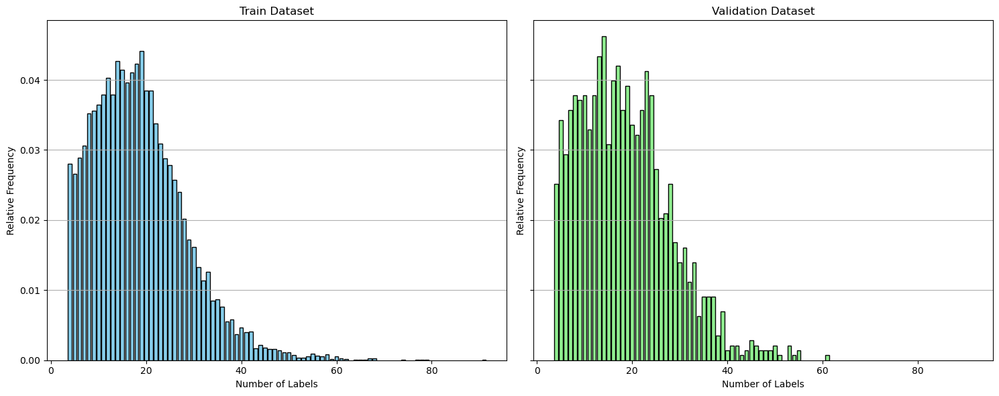

In [19]:
def count_labels(label_dir):
    label_counts = [len(open(os.path.join(label_dir, f)).readlines()) for f in os.listdir(label_dir)]
    return np.array(label_counts)

def plot_on_ax_rel_freq(ax, label_counts, color, title):
    values, counts = np.unique(label_counts, return_counts=True)
    relative_counts = counts / counts.sum()

    ax.bar(values, relative_counts, color=color, edgecolor='black', align='center')
    ax.set_title(title)
    ax.set_xlabel('Number of Labels')
    ax.set_ylabel('Relative Frequency')
    ax.grid(axis='y')


train_label_counts = count_labels(train_label_dir)
val_label_counts = count_labels(val_label_dir)

# Plotting
fig, axs = plt.subplots(1, 2, figsize=(15, 6), sharey=True)
plot_on_ax_rel_freq(axs[0], train_label_counts, 'skyblue', 'Train Dataset')
plot_on_ax_rel_freq(axs[1], val_label_counts, 'lightgreen', 'Validation Dataset')
axs[1].set_xlim(axs[0].get_xlim())

plt.tight_layout()
plt.show()

Here we can see, that the distribution looks almost alike, but you can clearly see, that the validation set is not as even, because it has less samples

## Widths and Heights of each Bounding Box


Next we look at the widths and heights of the labels in some scatterplots.

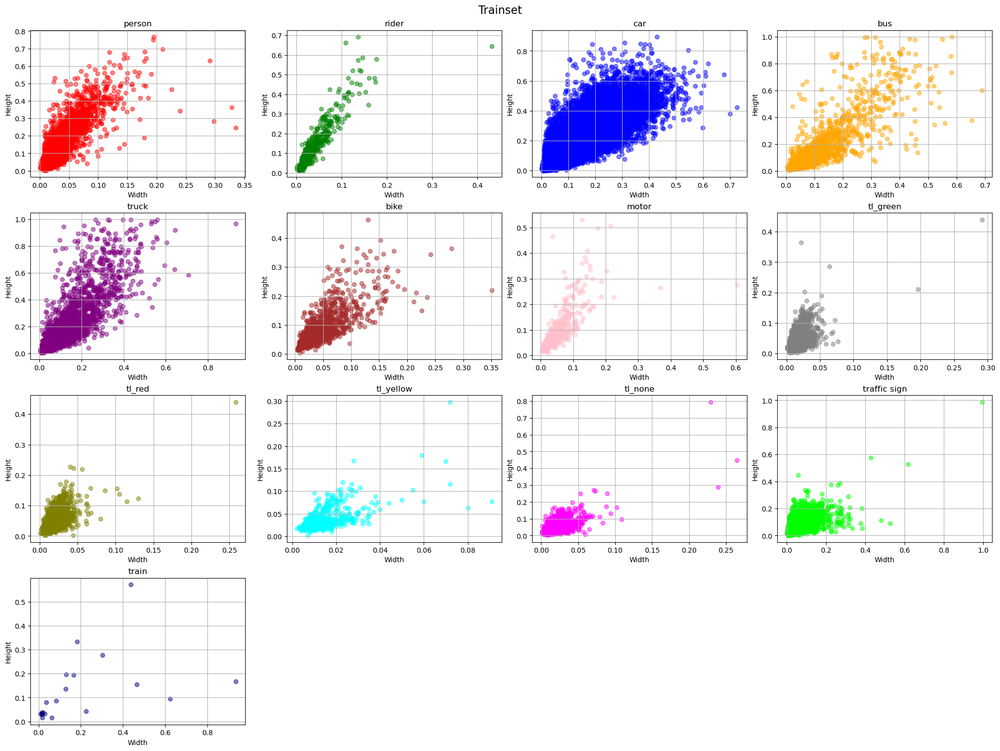

In [20]:
def plot_bb_width_height(label_dir, class_names, colors):
    bbox_sizes = {class_name: {'widths': [], 'heights': []} for class_name in class_names}

    for label_file in os.listdir(label_dir):
        with open(os.path.join(label_dir, label_file), 'r') as file:
            for line in file:
                class_id, _, _, width, height = map(float, line.split())
                bbox_sizes[class_names[int(class_id)]]['widths'].append(width)
                bbox_sizes[class_names[int(class_id)]]['heights'].append(height)

    # Plotting
    fig, axs = plt.subplots(4, 4, figsize=(20, 15), constrained_layout=True)
    for i, class_name in enumerate(class_names):
        ax = axs[i // 4, i%4]
        widths = bbox_sizes[class_name]['widths']
        heights = bbox_sizes[class_name]['heights']
        ax.scatter(widths, heights, alpha=0.5, color=colors[i])
        ax.set_title(f'{class_name}')
        ax.set_xlabel('Width')
        ax.set_ylabel('Height')
        ax.grid(True)


    for i in range(len(class_names), 16):
        axs.flatten()[i].axis('off')

    return fig



fig = plot_bb_width_height(train_label_dir, class_names, colors)
fig.suptitle('Trainset', fontsize=16)
plt.show()

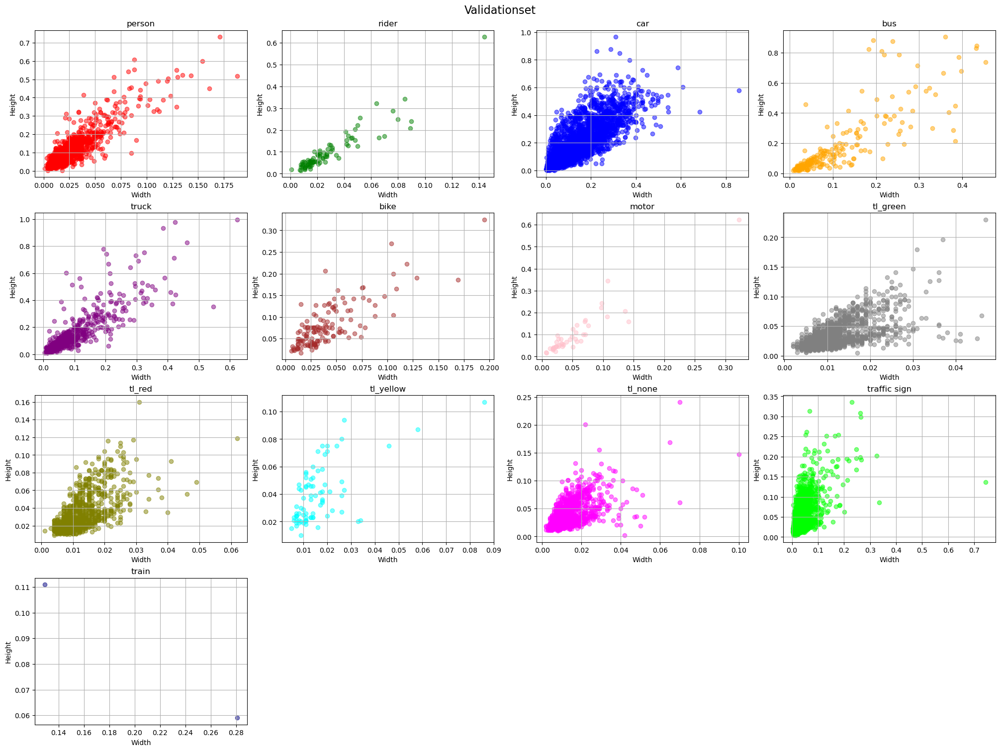

In [21]:
fig = plot_bb_width_height(val_label_dir,class_names,colors)
fig.suptitle('Validationset', fontsize=16)
plt.show()

Here we can also see, that our datasets are mostly similar, but the validationset has more variance, because it consists of less samples

## Example Images

Here we finally look at two example images which show how our dataset looks like.

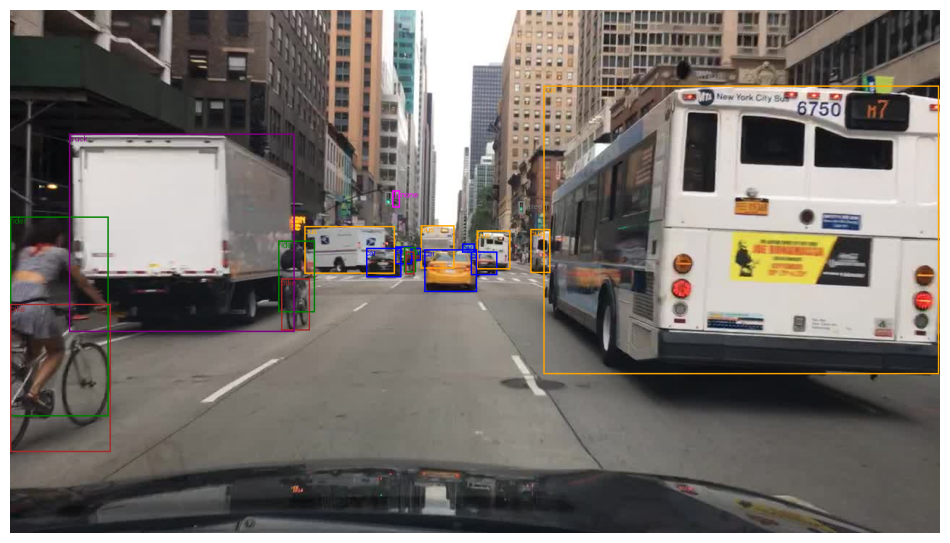

In [24]:
def create_image_and_labels(image_path, label_path, class_names, colors):
    image = Image.open(image_path)
    image_width, image_height = image.size
    draw = ImageDraw.Draw(image)

    with open(label_path, 'r') as file:
        for line in file:
            class_id, x_center, y_center, width, height = map(float, line.split())
            x_center, y_center, width, height = x_center * image_width, y_center * image_height, width * image_width, height * image_height
            left, top, right, bottom = x_center - width / 2, y_center - height / 2, x_center + width / 2, y_center + height / 2
            color = colors[int(class_id)]
            draw.rectangle(((left, top), (right, bottom)), outline=color, width=2)
            draw.text((left, top), f"{class_names[int(class_id)]}", fill=color)

    return image

image_path = "datasets/yolo-bdd10k/images/train/3dc827e3-f3a359ce.jpg"
label_path = "datasets/yolo-bdd10k/labels/train/3dc827e3-f3a359ce.txt"

image_with_boxes = create_image_and_labels(image_path, label_path, class_names, colors)

plt.figure(figsize=(12, 8))
plt.imshow(image_with_boxes)
plt.axis('off')
plt.show()

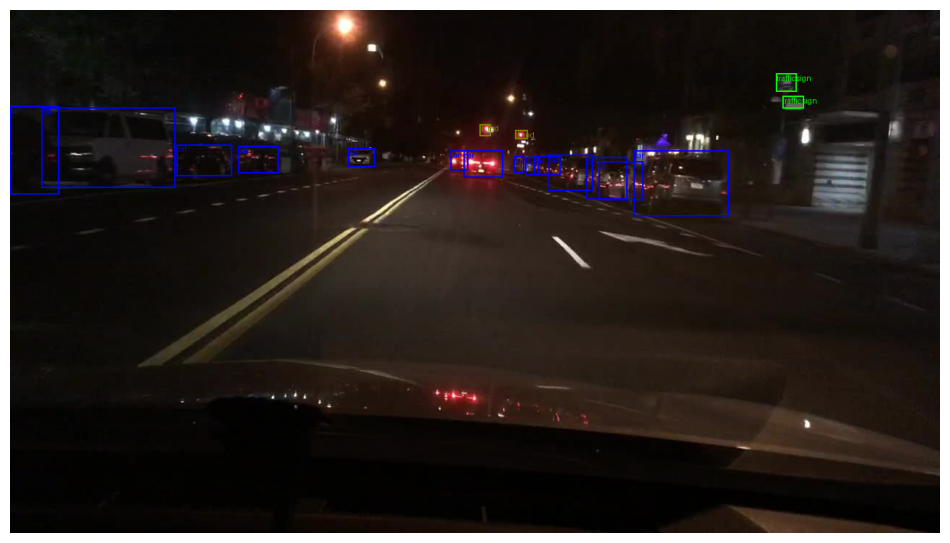

In [25]:
image_path = "datasets/yolo-bdd10k/images/train/9561e2f8-f991862f.jpg"
label_path = "datasets/yolo-bdd10k/labels/train/9561e2f8-f991862f.txt"

image_with_boxes = create_image_and_labels(image_path, label_path, class_names, colors)

plt.figure(figsize=(12, 8))
plt.imshow(image_with_boxes)
plt.axis('off')
plt.show()

# Training

In this section, you must explicitly explain your training process and the code to perform it.

In [26]:
import cv2
#! unzip "drive/MyDrive/JKU/ItAV/task1/runs.zip"

In [28]:
# !nvidia-smi
# !mkdir model

For all experiments the pretrained Yolov8 Large model is used which can be found here: https://github.com/ultralytics/ultralytics



In [ ]:
# Load a COCO-pretrained YOLOv8n model
coco_model_path = "./model/yolov8l.pt"
model = YOLO(coco_model_path)

# Display model information (optional)
model.info()

YOLOv8l summary: 365 layers, 43691520 parameters, 0 gradients, 165.7 GFLOPs


(365, 43691520, 0, 165.742848)

To monitor loss and evaluation metrics during training we use Tensorboard for more informed decisions when changing the hyperparameters:

In [30]:
%load_ext tensorboard
%tensorboard --logdir runs/detect
from tensorboard import notebook
#notebook.list() # View open TensorBoard instances

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 16332), started 0:00:28 ago. (Use '!kill 16332' to kill it.)

## Reference experiment

This section should detail the results of the reference experiment where you use your selected model in the selected dataset WITHOUT training. It should include training metrics and a detailed explanation of the algorithm's performances.

We have two approaches to allow for a fair comparison between untrained and trained model.
1. The first model is completely untrained and has never seen the BDD100k images
2. The second model is trained for 20 epochs, but we only change the weights of the final layer (to at least allow for adjustments to the newly introduced and unseen labels), which means all other layers are completely frozen and unchanged.

In [ ]:
# Model 1

# TODO: Validation takes wrong classes?!

In [ ]:
# Model 2
results = model.train(
    task='detect',
    mode='val',
    model=coco_model_path,
    data='./datasets/yolo-bdd10k/dataset.yaml',
    epochs=1,
    patience=5,
    batch=-1,
    imgsz=640,
    cache=True,
    device='cuda:0',
    workers=8,
    pretrained=coco_model_path,
    verbose=True,
    seed=random_seed,
    freeze=21,
    plots=True,
    #**augmentations
    )
# TODO: Run this for longer, the metrics were pretty good for this model even though only the last layer was trained for 1 epoch

## Improve on the reference
This section should detail the results of the reference experiment where you use your selected model in the selected dataset AFTER training. It should include training metrics and a detailed explanation of the algorithm's performances.

In the following cells we can adjust all Hyperparameters for the model. Next to some tweaks to the learning rate we increase the importance of the cls loss term, since the model confuses many objects with the background (maybe because of the skewed class distributiun). We also change the default augmentations applied by YoloV8. For example we disable mixup and mosaic augmentation and adjust values for translation, scale, perspective. Extra care is put on augmenting the image in thoughtful ways to accommodate the traffic setting. For example, while a horizontal flip can make sense to better detect vehicles, a vertical flip would never occur (not in a normal setting) in real life, which is why we disable this kind of augmentation. Additionally we install the albumentation library to enable albumentations such as

- Blur(p=0.01, blur_limit=(3, 7))
- MedianBlur(p=0.01, blur_limit=(3, 7))
- ToGray(p=0.01)
- CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

**Example images augmentation:**

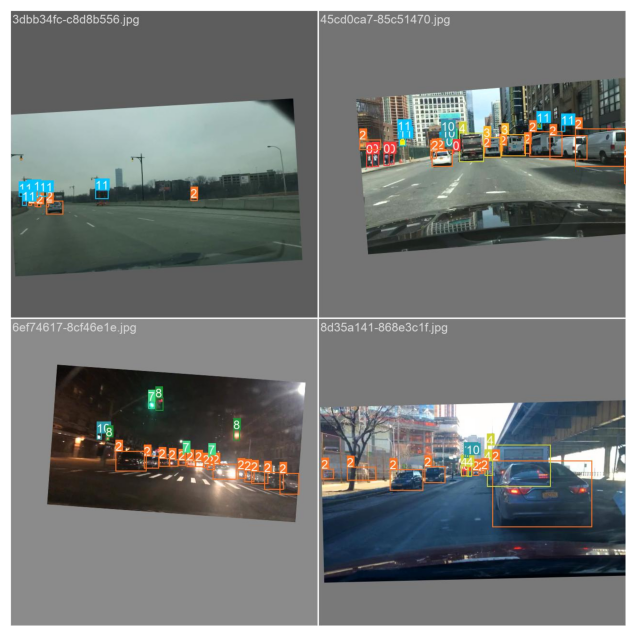

In [ ]:
img = Image.open("runs/detect/train5/train_batch25001.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)
# TODO: Default augmentations works almost the same as ours so maybe even increase augmentation a bit?

In [ ]:
# Augmentations / Hyperparameters:
####################################
augmentations = {
'lr0': 0.05,  # initial learning rate (i.e. SGD=1E-2, Adam=1E-3)
'lrf': 0.01,  # final learning rate (lr0 * lrf)
'momentum': 0.937,  # SGD momentum/Adam beta1
'weight_decay': 0.0005,  # optimizer weight decay 5e-4
'warmup_epochs': 1.0,  # warmup epochs (fractions ok)
'warmup_momentum': 0.8,  # warmup initial momentum
'warmup_bias_lr': 0.1, # warmup initial bias lr
'box': 7.5,  # box loss gain
'cls': 1.5,  # cls loss gain (scale with pixels)
'dfl': 1.5,  # dfl loss gain
#'pose': 12.0,  # pose loss gain
#'kobj': 1.0,  # keypoint obj loss gain
'label_smoothing': 0.05,  # label smoothing (fraction)
#'nbs': 64  # nominal batch size
'hsv_h': 0.015,  # image HSV-Hue augmentation (fraction)
'hsv_s': 0.4,  # image HSV-Saturation augmentation (fraction)
'hsv_v': 0.3,  # image HSV-Value augmentation (fraction)
'degrees': 5,  # image rotation (+/- deg)
'translate': 0.13,  # image translation (+/- fraction)
'scale': 0.25,  # image scale (+/- gain)
'shear': 0.0,  # image shear (+/- deg) from -0.5 to 0.5
'perspective': 0.000001,  # image perspective (+/- fraction), range 0-0.001
'flipud': 0.0,  # image flip up-down (probability)
'fliplr': 0.5,  # image flip left-right (probability)
'mosaic': 0.0,  # image mosaic (probability)
'mixup': 0.0,  # image mixup (probability)
'copy_paste': 0.0,  # segment copy-paste (probability)
'erasing': 0.2,
}
# TODO: Cls up? lr0?

In [ ]:
# Train the model on the COCO8 example dataset for 100 epochs
results = model.train(
    task='detect',
    mode='train',
    model=coco_model_path,
    data='./datasets/yolo-bdd10k/dataset.yaml',
    epochs=20,
    patience=5,
    batch=-1,
    imgsz=640,
    cache=True,
    device='cuda:0',
    workers=8,
    pretrained=coco_model_path,
    verbose=True,
    seed=random_seed,
    #resume=True,
    #dropout=0.2,
    #freeze=3,
    plots=True,
    #**augmentations
    )

Ultralytics YOLOv8.1.24 🚀 Python-3.10.12 torch-2.2.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=./model/yolov8l.pt, data=/content/dataset/yolo-bdd100k/dataset.yaml, epochs=1, time=None, patience=5, batch=-1, imgsz=640, save=True, save_period=-1, cache=True, device=cuda:0, workers=8, project=None, name=train2, exist_ok=False, pretrained=./model/yolov8l.pt, optimizer=auto, verbose=True, seed=2024, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=10, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, s

train: Scanning /content/dataset/yolo-bdd100k/labels/train... 69863 images, 151 backgrounds, 0 corrupt: 100%|██████████| 70000/70000 [01:02<00:00, 1111.69it/s]

train: WARNING ⚠️ /content/dataset/yolo-bdd100k/images/train/75055858-7d04a650.jpg: 1 duplicate labels removed


train: New cache created: /content/dataset/yolo-bdd100k/labels/train.cache


train: Caching images (45.1GB True): 100%|██████████| 70000/70000 [11:51<00:00, 98.44it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/dataset/yolo-bdd100k/labels/val... 10000 images, 4 backgrounds, 0 corrupt: 100%|██████████| 10000/10000 [00:20<00:00, 484.98it/s]


val: New cache created: /content/dataset/yolo-bdd100k/labels/val.cache


val: Caching images (6.4GB True): 100%|██████████| 10000/10000 [01:46<00:00, 93.79it/s]


Plotting labels to runs/detect/train2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 97 weight(decay=0.0), 104 weight(decay=0.000546875), 103 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train2
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      8.38G      1.436      4.828      1.085       1098        640:   0%|          | 2/2000 [00:31<7:17:34, 13.14s/it] 

### Validation and evaluation

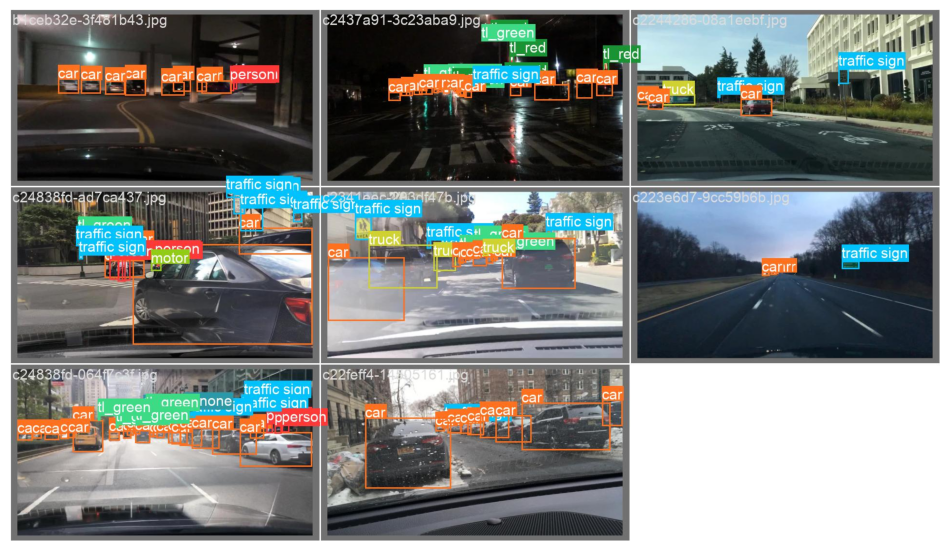

In [ ]:
img = Image.open("./runs/detect/train5/val_batch0_labels.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

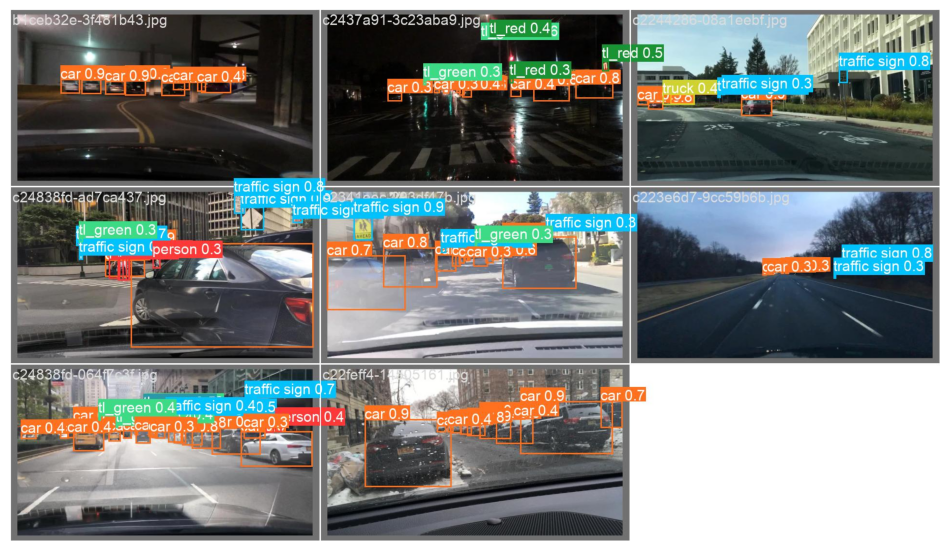

In [ ]:
img = Image.open("./runs/detect/train5/val_batch0_pred.jpg")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)

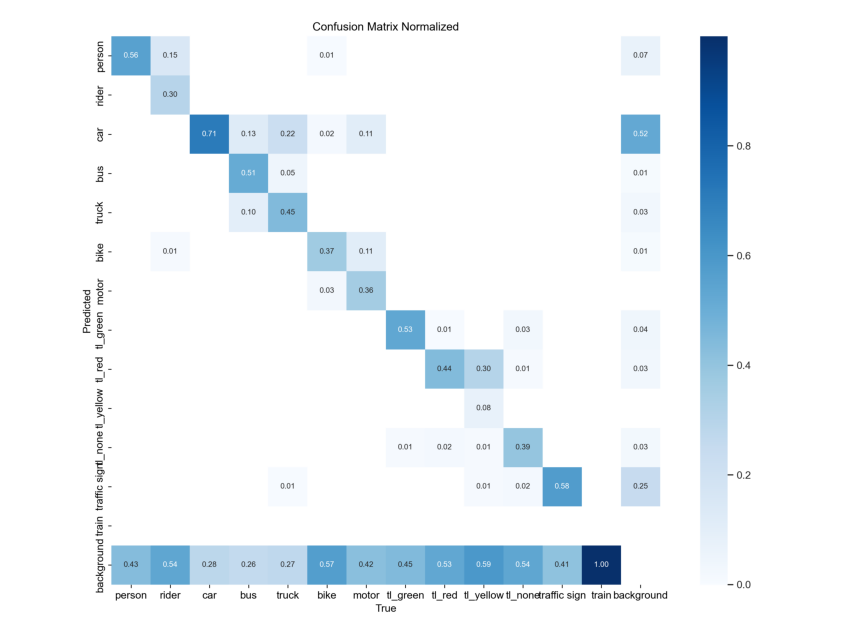

In [ ]:
img = Image.open("./runs/detect/train5/confusion_matrix_normalized.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)
# TODO: Many classes are predicted background according to this... Also really hard to detect trains with 2 samples, maybe add more trains to training data or increase class weights?

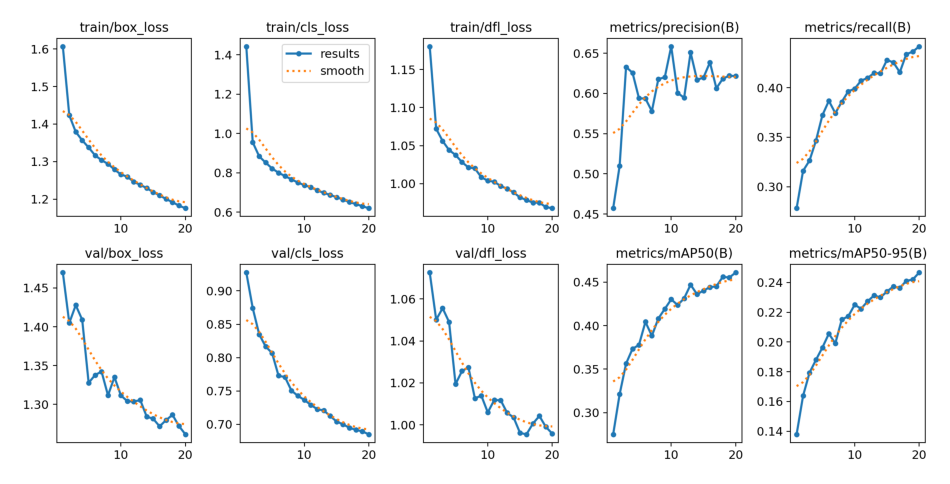

In [ ]:
img = Image.open("./runs/detect/train5/results.png")
plt.figure(figsize=(12, 8))
plt.axis('off')
plt.imshow(img)
# TODO: According to these plots we easily could run more epochs when we have good settings

# Video example:

In [ ]:
from ultralytics import YOLO

#model = YOLO('./model/train6_best.pt')
model = YOLO('./model/yolov8l.pt')
source = 'example_video/0000f77c-6257be58.mov'

# Run inference on the source
results = model(source, stream=False, save=True, show=False)  # generator of Results objects

In [32]:
!ffmpeg -i runs/detect/predict_train1/IMG_0197.avi runs/detect/predict_train1/IMG_0197.mp4

ffmpeg version 6.1 Copyright (c) 2000-2023 the FFmpeg developers
  built with clang version 17.0.6
  configuration: --prefix=/d/bld/ffmpeg_1701804246982/_h_env/Library --cc=clang.exe --cxx=clang++.exe --nm=llvm-nm --ar=llvm-ar --disable-doc --disable-openssl --enable-demuxer=dash --enable-hardcoded-tables --enable-libfreetype --enable-libharfbuzz --enable-libfontconfig --enable-libopenh264 --enable-libdav1d --ld=lld-link --target-os=win64 --enable-cross-compile --toolchain=msvc --host-cc=clang.exe --extra-libs=ucrt.lib --extra-libs=vcruntime.lib --extra-libs=oldnames.lib --strip=llvm-strip --disable-stripping --host-extralibs= --enable-gpl --enable-libx264 --enable-libx265 --enable-libaom --enable-libsvtav1 --enable-libxml2 --enable-pic --enable-shared --disable-static --enable-version3 --enable-zlib --enable-libopus --pkg-config=/d/bld/ffmpeg_1701804246982/_build_env/Library/bin/pkg-config
  libavutil      58. 29.100 / 58. 29.100
  libavcodec     60. 31.102 / 60. 31.102
  libavformat 

In [ ]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('0000f77c-6257be58.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video controls>
      <source src="%s" type="video/mp4">
</video>++++++++++
""" % data_url)